**IMPORT RELEVANT PACKAGES**

In [ ]:
import os
import sys
from tempfile import NamedTemporaryFile
from urllib.request import urlopen
from urllib.parse import unquote, urlparse
from urllib.error import HTTPError
from zipfile import ZipFile
import tarfile
import shutil
import json

In [ ]:
import torch
import torchvision

---
# Note: The following notebook need to executed on GPU Runtime only

**MultiScaleDeformableAttention Dependencies in DINO-DETR**

---

## 1. Setting up the repository
  https://github.com/IDEA-Research/DINO.git

  and follow the instruction given in the repository

In [ ]:
# !git clone https://github.com/IDEA-Research/DINO.git

Cloning into 'DINO'...
remote: Enumerating objects: 442, done.
remote: Counting objects: 100% (196/196), done.
remote: Compressing objects: 100% (101/101), done.
remote: Total 442 (delta 136), reused 95 (delta 95), pack-reused 246 (from 1)
Receiving objects: 100% (442/442), 13.43 MiB | 6.46 MiB/s, done.
Resolving deltas: 100% (191/191), done.


In [ ]:
# !mv -v /content/DINO/* /content/

renamed '/content/DINO/config' -> '/content/config'
renamed '/content/DINO/datasets' -> '/content/datasets'
renamed '/content/DINO/engine.py' -> '/content/engine.py'
renamed '/content/DINO/figs' -> '/content/figs'
renamed '/content/DINO/inference_and_visualization.ipynb' -> '/content/inference_and_visualization.ipynb'
renamed '/content/DINO/LICENSE' -> '/content/LICENSE'
renamed '/content/DINO/main.py' -> '/content/main.py'
renamed '/content/DINO/models' -> '/content/models'
renamed '/content/DINO/README.md' -> '/content/README.md'
renamed '/content/DINO/requirements.txt' -> '/content/requirements.txt'
renamed '/content/DINO/run_with_submitit.py' -> '/content/run_with_submitit.py'
renamed '/content/DINO/scripts' -> '/content/scripts'
renamed '/content/DINO/tools' -> '/content/tools'
renamed '/content/DINO/util' -> '/content/util'


In [ ]:
# !rm -rf /content/DINO

**Install the required dependencies**

In [ ]:
!pip install -r requirements.txt

  Cloning https://github.com/cocodataset/cocoapi.git to /tmp/pip-install-de6gbgdb/pycocotools_2b471360d43b4634a860217b6b9d683f
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/cocoapi.git /tmp/pip-install-de6gbgdb/pycocotools_2b471360d43b4634a860217b6b9d683f
  Resolved https://github.com/cocodataset/cocoapi.git to commit 8c9bcc3cf640524c4c20a9c40e89cb6a2f2fa0e9
  Preparing metadata (setup.py) ... done
  Cloning https://github.com/cocodataset/panopticapi.git to /tmp/pip-install-de6gbgdb/panopticapi_324eb31fb2df4198bbfbce48de555a86
  Running command git clone --filter=blob:none --quiet https://github.com/cocodataset/panopticapi.git /tmp/pip-install-de6gbgdb/panopticapi_324eb31fb2df4198bbfbce48de555a86
  Resolved https://github.com/cocodataset/panopticapi.git to commit 7bb4655548f98f3fedc07bf37e9040a992b054b0
  Preparing metadata (setup.py) ... done
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 45.4/45.4 kB 4.4 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━

### builds the MultiScaleDeformableAttention module from [Deformable-DETR]
as instructed , it will give throws some erros but no need to worry

In [ ]:
!python models/dino/ops/setup.py build install

running build
running build_py
creating build
creating build/lib.linux-x86_64-cpython-310
creating build/lib.linux-x86_64-cpython-310/datasets
copying datasets/random_crop.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/sltransform.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/panoptic_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_eval.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/data_util.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/dataset.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/__init__.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/transforms.py -> build/lib.linux-x86_64-cpython-310/datasets
copying datasets/coco_panoptic.py -> build/lib.linux-x86_64-cpython-310/datasets
creating build/lib.linux-x86_64-cpython-310/util
copying util/box_loss.py -> build

#### WARANING: GPU will run out of memory but will not cause significant issue

In [ ]:
!python models/dino/ops/test.py

* True check_forward_equal_with_pytorch_double: max_abs_err 8.67e-19 max_rel_err 2.35e-16
* True check_forward_equal_with_pytorch_float: max_abs_err 4.66e-10 max_rel_err 1.13e-07
* True check_gradient_numerical(D=30)
* True check_gradient_numerical(D=32)
* True check_gradient_numerical(D=64)
* True check_gradient_numerical(D=71)
* True check_gradient_numerical(D=1025)
Traceback (most recent call last):
  File "/content/models/dino/ops/test.py", line 86, in <module>
    check_gradient_numerical(channels, True, True, True)
  File "/content/models/dino/ops/test.py", line 76, in check_gradient_numerical
    gradok = gradcheck(func, (value.double(), shapes, level_start_index, sampling_locations.double(), attention_weights.double(), im2col_step))
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2053, in gradcheck
    return _gradcheck_helper(**args)
  File "/usr/local/lib/python3.10/dist-packages/torch/autograd/gradcheck.py", line 2082, in _gradcheck_helper


### Custom Dataset

The dataset have been formated in the coco style which can be obtained from the following link

[insert link here]

In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [ ]:
!cp -r /content/drive/MyDrive/DINO/checkpoint0033_4scale.pth /content/

In [ ]:
!cp /content/drive/MyDrive/DINO/coco_dataset.zip /content/
!unzip coco_dataset.zip

### T1.2 Imports

In [ ]:
import time
import random
import numpy as np
import matplotlib.pyplot as plt
import cv2

try:
  import xml.etree.ElementTree as ET
except:
  print("Installing xml Element Tree...")
  !pip install xml
  import xml.etree.ElementTree as ET

## T2 Download Pretrained model (R50, 4scale)
  can be download from the link given in the repository

In [ ]:
# def parse_annotation(xml_file):
#     tree = ET.parse(xml_file)
#     root = tree.getroot()

#     boxes = []
#     for obj in root.iter('object'):
#         xmin = int(obj.find('bndbox').find('xmin').text)
#         ymin = int(obj.find('bndbox').find('ymin').text)
#         xmax = int(obj.find('bndbox').find('xmax').text)
#         ymax = int(obj.find('bndbox').find('ymax').text)
#         boxes.append((xmin, ymin, xmax, ymax))

#     return boxes

In [ ]:
def plot_bounding_boxes(image_path, boxes):
    image = cv2.imread(image_path)

    for box in boxes:
        xmin, ymin, xmax, ymax = box
        cv2.rectangle(image, (xmin, ymin), (xmax, ymax), (0, 255, 0), 2)

    return image

In [ ]:
# To verify difference between the two jsons (and to correct them)


orig = "/content/coco_dataset/annotations/instances_val2017.json"
new = "/content/coco_dataset/annotations/instances_val2017.json"

# Read JSON data from the file
with open(orig, 'r') as f1:
    orig_d = json.load(f1)

with open(new, 'r') as f2:
    new_d = json.load(f2)

print(orig_d['images'][4])
print(f"---------")
print(new_d['images'][4])

{'id': 185, 'file_name': '16154.jpg', 'width': 640, 'height': 480}
---------
{'id': 185, 'file_name': '16154.jpg', 'width': 640, 'height': 480}


The pycocotools in the requirements.txt file is outdated, and it causes errors so , uninstall the current and get a new one

In [ ]:
!pip uninstall pycocotools
!pip install pycocotools

Found existing installation: pycocotools 2.0.8
Uninstalling pycocotools-2.0.8:
  Would remove:
    /usr/local/lib/python3.10/dist-packages/pycocotools-2.0.8.dist-info/*
    /usr/local/lib/python3.10/dist-packages/pycocotools/*
Proceed (Y/n)? Y
  Successfully uninstalled pycocotools-2.0.8
  Using cached pycocotools-2.0.8-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl.metadata (1.1 kB)
Using cached pycocotools-2.0.8-cp310-cp310-manylinux_2_17_x86_64.manylinux2014_x86_64.whl (427 kB)


In [ ]:
import warnings
warnings.filterwarnings('ignore')

## Evaluation on Validation Set    

In [ ]:
!bash /content/scripts/DINO_eval.sh /content/coco_dataset /content/checkpoint0033_4scale.pth

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/23 19:00:46.701]: git:
  sha: N/A, status: clean, branch: N/A

[09/23 19:00:46.701]: Command: main.py --output_dir logs/DINO/R50-MS4-%j -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/checkpoint0033_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/23 19:00:46.702]: Full config saved to logs/DINO/R50-MS4-%j/config_args_all.json
[09/23 19:00:46.702]: world size: 1
[09/23 19:00:46.702]: rank: 0
[09/23 19:00:46.702]: local_rank: 0
[09/23 19:00:46.702]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/coco_dataset', coco_panoptic_path

## Visualizations & Logging of information


In [ ]:
!python main.py --save_results --output_dir logs/DINO/R50-MS4-B -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/checkpoint0033_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/23 19:09:02.922]: git:
  sha: N/A, status: clean, branch: N/A

[09/23 19:09:02.922]: Command: main.py --save_results --output_dir logs/DINO/R50-MS4-B -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/checkpoint0033_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/23 19:09:02.923]: Full config saved to logs/DINO/R50-MS4-B/config_args_all.json
[09/23 19:09:02.923]: world size: 1
[09/23 19:09:02.923]: rank: 0
[09/23 19:09:02.923]: local_rank: 0
[09/23 19:09:02.923]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/coco_dataset', coco_

Load the R50 model and perform evaluation

In [ ]:
t5 = torch.load('/content/checkpoint0033_4scale.pth') # load the R50 4 scale model

In [ ]:
json_train = "/content/coco_dataset/annotations/instances_train2017.json"
json_val = "/content/coco_dataset/annotations/instances_val2017.json"

In [ ]:
# Map json to dataset imgs and draw bbs around themwith open('data.json') as json_file:

# Open the JSON file
with open(json_val) as json_file:
    # Load the JSON data
    data = json.load(json_file)

In [ ]:
from util.slconfig import SLConfig
from datasets import build_dataset
from util.visualizer import COCOVisualizer
from util import box_ops

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


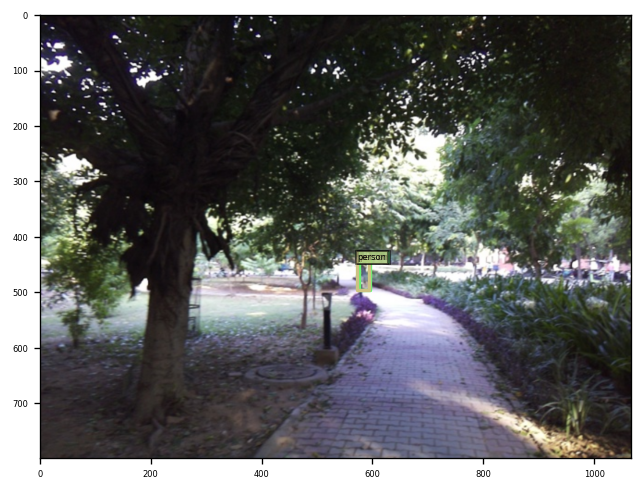

savename: /content/figs/original/orig_0000-2-2024-09-23-19:32:09.592849.png
Image ID 2 not found in t5


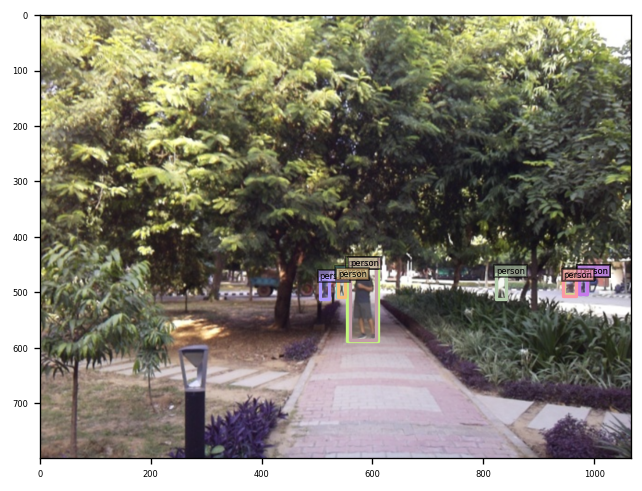

savename: /content/figs/original/orig_0001-7-2024-09-23-19:32:10.341597.png
Image ID 7 not found in t5


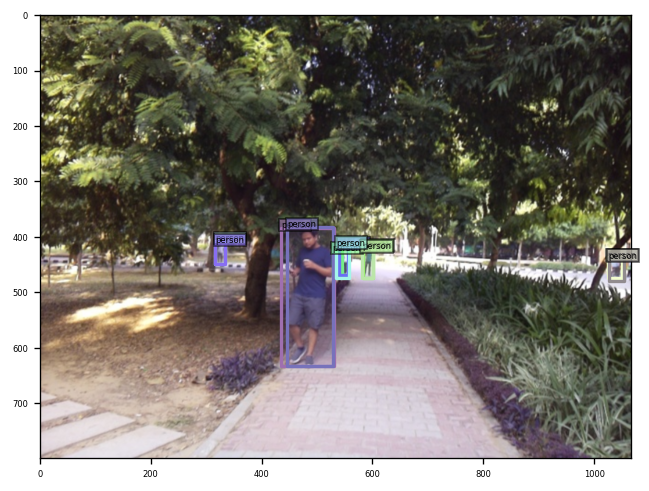

savename: /content/figs/original/orig_0002-8-2024-09-23-19:32:11.097152.png
Image ID 8 not found in t5


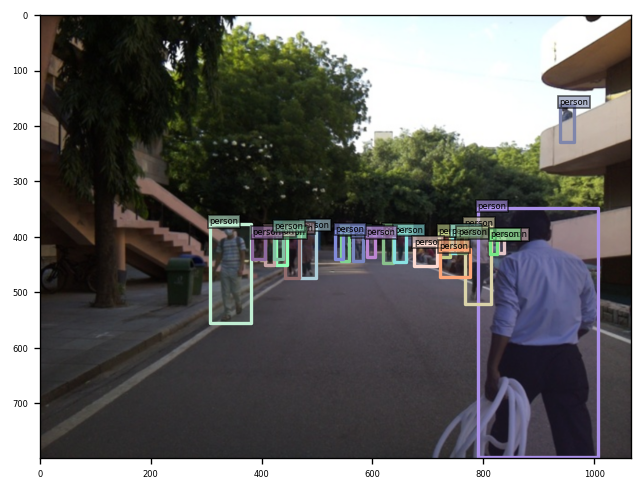

savename: /content/figs/original/orig_0003-9-2024-09-23-19:32:11.861776.png
Image ID 9 not found in t5


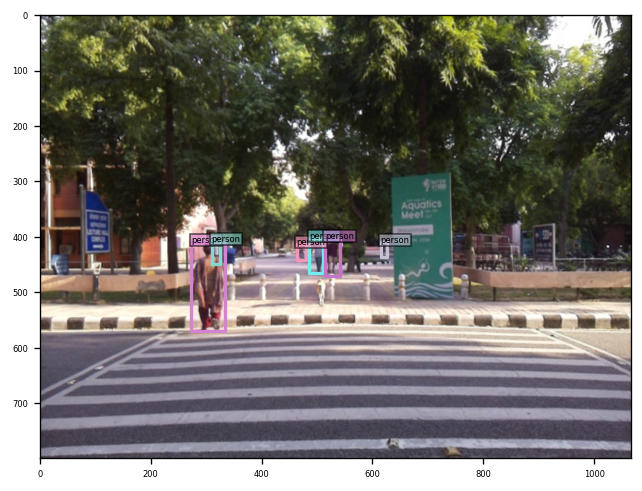

savename: /content/figs/original/orig_0004-23-2024-09-23-19:32:12.408717.png
Image ID 23 not found in t5


In [ ]:
model_config_path = "config/DINO/DINO_4scale.py"
args = SLConfig.fromfile(model_config_path)

args.device = 'cuda'
args.dataset_file = 'coco'
args.coco_path = "/content/coco_dataset"  # the path of coco
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)
vslzr = COCOVisualizer()
vslzr_2 = COCOVisualizer()

# Modify to select only 5 samples
for i, batch in enumerate(dataset_val):
    if i >= 5:  # Stop after processing 5 samples
        break
    img, targets = batch
    box_label = ['person' for item in targets['labels']]
    gt_dict = {
        'boxes': targets['boxes'],
        'image_id': targets['image_id'],
        'size': targets['size'],
        'box_label': box_label,
    }
    vslzr.visualize(img, gt_dict, caption=f"orig_{str(i).zfill(4)}", savedir="/content/figs/original")

    img_id = int(targets['image_id'].detach().cpu().numpy())
    if img_id in t5:
        box_label_pred = ['person' for ite in t5[img_id]['pred_boxes']]
        H, W = [480, 600]  # norm with original image size
        pred_dict = {
            'boxes': t5[img_id]['pred_boxes'].cpu() / torch.Tensor([W, H, W, H]),
            'image_id': targets['image_id'].cpu(),
            'size': t5[img_id]['size'].cpu(),
            'box_label': box_label_pred,
        }
        vslzr_2.visualize(img, pred_dict, caption=f"pred_{str(i).zfill(4)}", savedir="/content/figs/pred")
    else:
        print(f"Image ID {img_id} not found in t5")


## Decoder layerwise-visualizations

Ran after making changes to:
> models/dino/deformable_transformer.py   

In [ ]:
!python main.py --save_results --output_dir logs/DINO/R50-MS4-B -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/checkpoint0033_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/23 19:33:45.758]: git:
  sha: N/A, status: clean, branch: N/A

[09/23 19:33:45.758]: Command: main.py --save_results --output_dir logs/DINO/R50-MS4-B -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/checkpoint0033_4scale.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/23 19:33:45.759]: Full config saved to logs/DINO/R50-MS4-B/config_args_all.json
[09/23 19:33:45.759]: world size: 1
[09/23 19:33:45.759]: rank: 0
[09/23 19:33:45.759]: local_rank: 0
[09/23 19:33:45.759]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file='coco', coco_path='/content/coco_dataset', coco_

## Fine-tuning on the training set (pre-trained: R50-12epochs -> fine-tuned: 5 epochs)
   

Train - Val steps:

> logs at: logs/DINO/fine_tune_R50-MS4

In [ ]:
!python main.py --finetune_ignore label_enc.weight class_embed --pretrain_model_path /content/checkpoint0033_4scale.pth --output_dir logs/DINO/fine_tune_R50-MS4 -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/23 19:37:22.100]: git:
  sha: N/A, status: clean, branch: N/A

[09/23 19:37:22.100]: Command: main.py --finetune_ignore label_enc.weight class_embed --pretrain_model_path /content/checkpoint0033_4scale.pth --output_dir logs/DINO/fine_tune_R50-MS4 -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/23 19:37:22.101]: Full config saved to logs/DINO/fine_tune_R50-MS4/config_args_all.json
[09/23 19:37:22.101]: world size: 1
[09/23 19:37:22.101]: rank: 0
[09/23 19:37:22.101]: local_rank: 0
[09/23 19:37:22.101]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset

### Perceptual Validation AP improved!

In [ ]:
!python main.py --save_results --output_dir logs/DINO/eval_finetune_R50-MS4-x -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/logs/DINO/fine_tune_R50-MS4/checkpoint0005.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0

Not using distributed mode
Loading config file from config/DINO/DINO_4scale.py
fatal: not a git repository (or any of the parent directories): .git
[09/23 20:01:09.832]: git:
  sha: N/A, status: clean, branch: N/A

[09/23 20:01:09.832]: Command: main.py --save_results --output_dir logs/DINO/eval_finetune_R50-MS4-x -c config/DINO/DINO_4scale.py --coco_path /content/coco_dataset --eval --resume /content/logs/DINO/fine_tune_R50-MS4/checkpoint0005.pth --options dn_scalar=100 embed_init_tgt=TRUE dn_label_coef=1.0 dn_bbox_coef=1.0 use_ema=False dn_box_noise_scale=1.0
[09/23 20:01:09.833]: Full config saved to logs/DINO/eval_finetune_R50-MS4-x/config_args_all.json
[09/23 20:01:09.833]: world size: 1
[09/23 20:01:09.833]: rank: 0
[09/23 20:01:09.833]: local_rank: 0
[09/23 20:01:09.833]: args: Namespace(config_file='config/DINO/DINO_4scale.py', options={'dn_scalar': 100, 'embed_init_tgt': True, 'dn_label_coef': 1.0, 'dn_bbox_coef': 1.0, 'use_ema': False, 'dn_box_noise_scale': 1.0}, dataset_file

In [ ]:
t5 = torch.load('/content/logs/DINO/fine_tune_R50-MS4/checkpoint0005.pth')

In [ ]:
# Map json to dataset imgs and draw bbs around themwith open('data.json') as json_file:
# Open the JSON file
with open(json_val) as json_file:
    # Load the JSON data
    data = json.load(json_file)

data_aug_params: {
  "scales": [
    480,
    512,
    544,
    576,
    608,
    640,
    672,
    704,
    736,
    768,
    800
  ],
  "max_size": 1333,
  "scales2_resize": [
    400,
    500,
    600
  ],
  "scales2_crop": [
    384,
    600
  ]
}
loading annotations into memory...
Done (t=0.00s)
creating index...
index created!


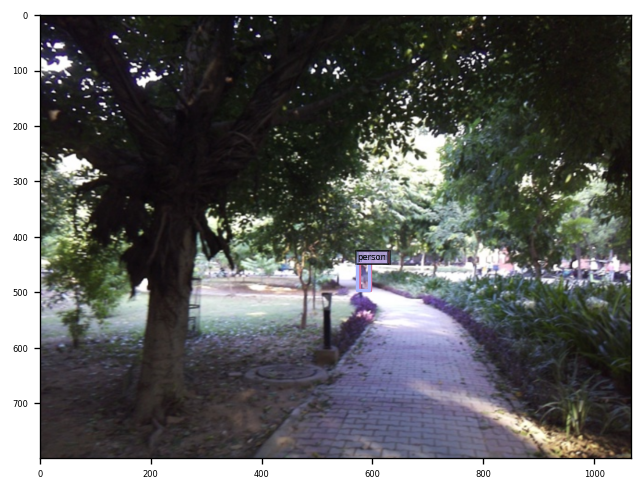

savename: /content/figs/original/orig_0000-2-2024-09-23-20:10:03.575118.png
2 not found


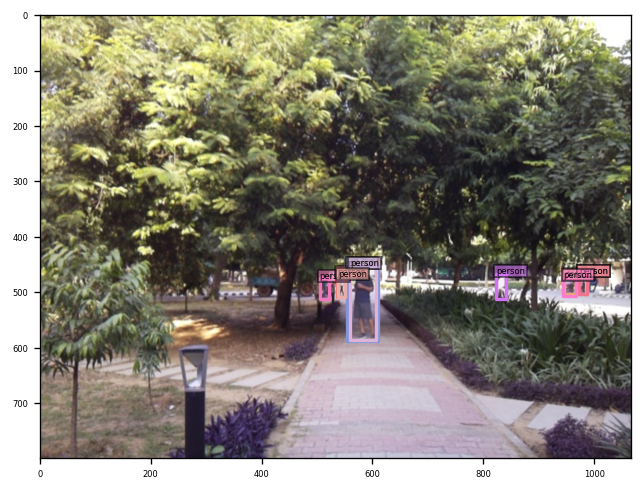

savename: /content/figs/original/orig_0001-7-2024-09-23-20:10:04.124493.png
7 not found


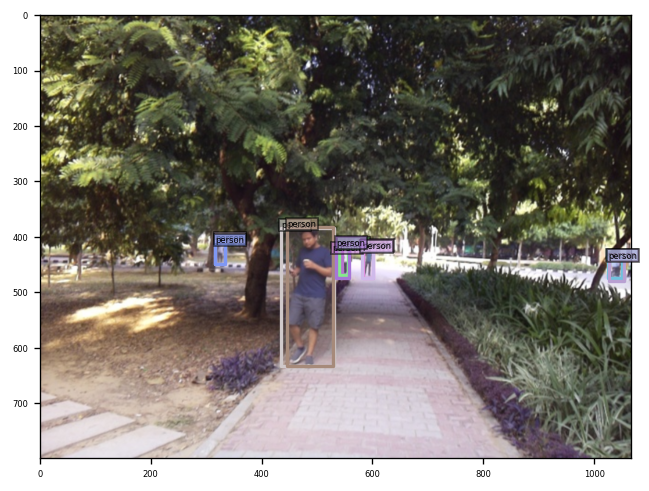

savename: /content/figs/original/orig_0002-8-2024-09-23-20:10:04.732086.png
8 not found


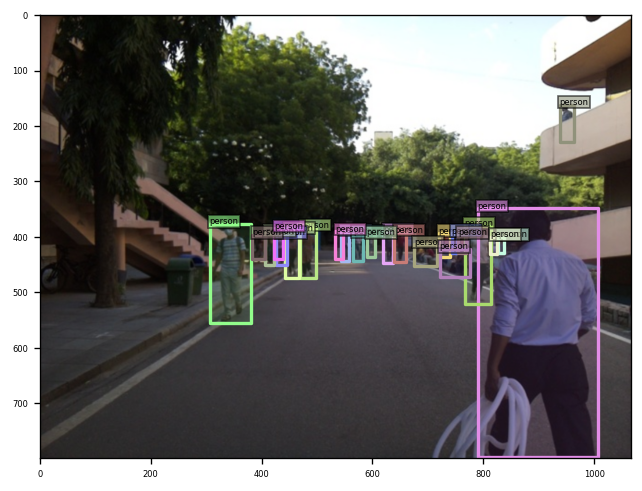

savename: /content/figs/original/orig_0003-9-2024-09-23-20:10:05.278471.png
9 not found


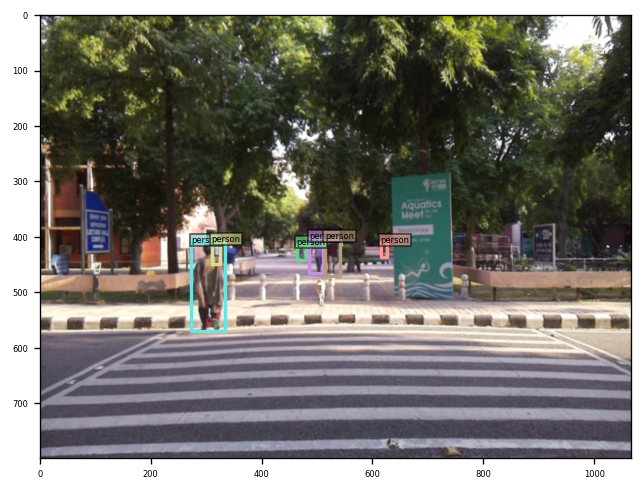

savename: /content/figs/original/orig_0004-23-2024-09-23-20:10:05.838872.png
23 not found


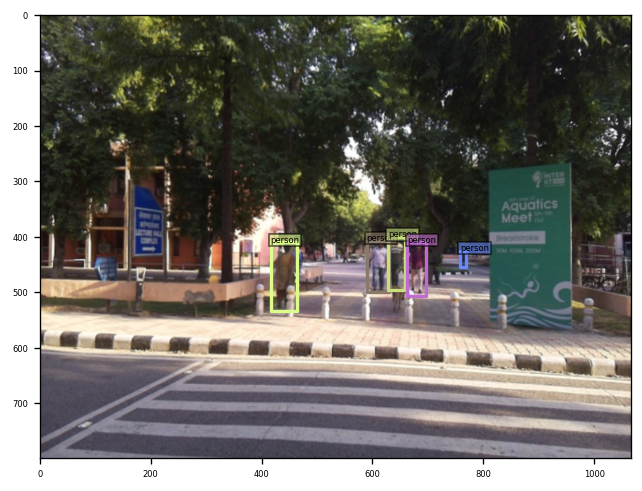

savename: /content/figs/original/orig_0005-24-2024-09-23-20:10:06.396962.png
24 not found


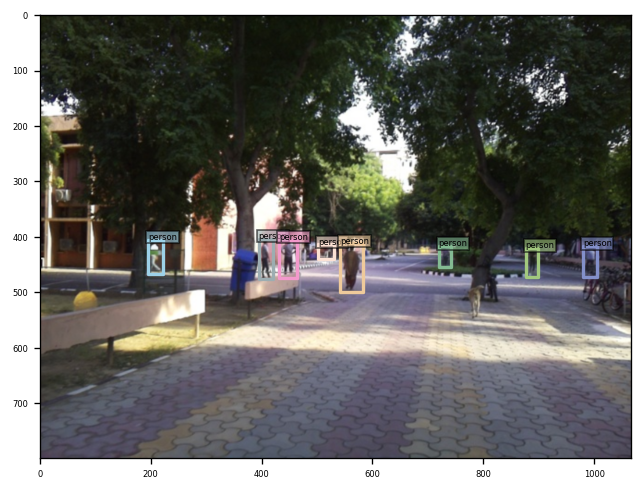

savename: /content/figs/original/orig_0006-27-2024-09-23-20:10:06.986395.png
27 not found


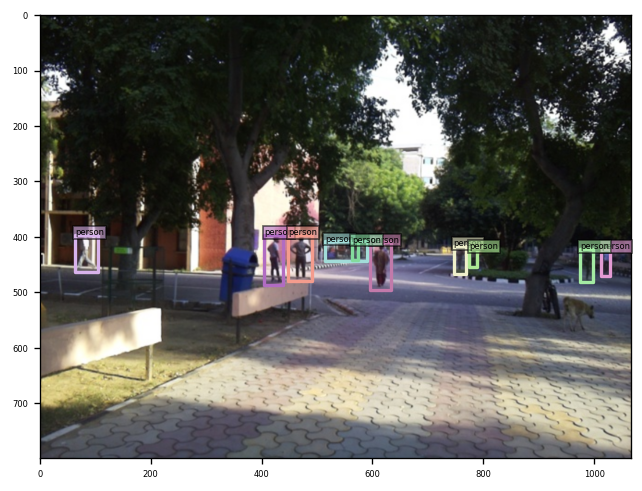

savename: /content/figs/original/orig_0007-29-2024-09-23-20:10:07.706916.png
29 not found


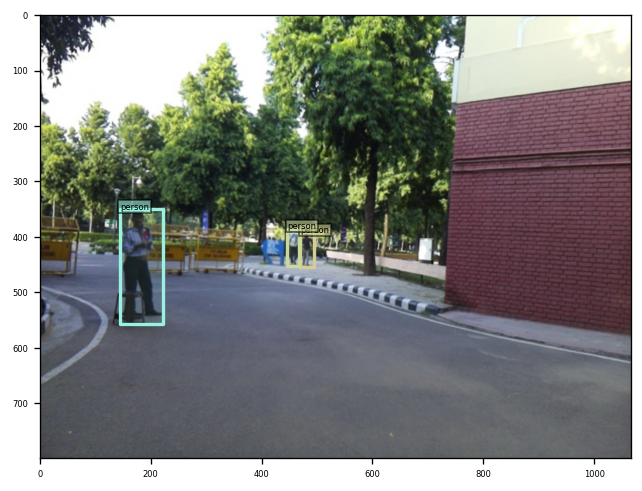

savename: /content/figs/original/orig_0008-36-2024-09-23-20:10:08.370289.png
36 not found


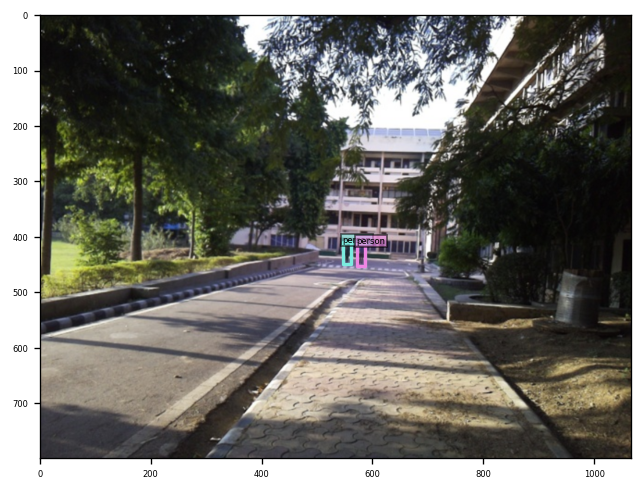

savename: /content/figs/original/orig_0009-40-2024-09-23-20:10:09.113662.png
40 not found


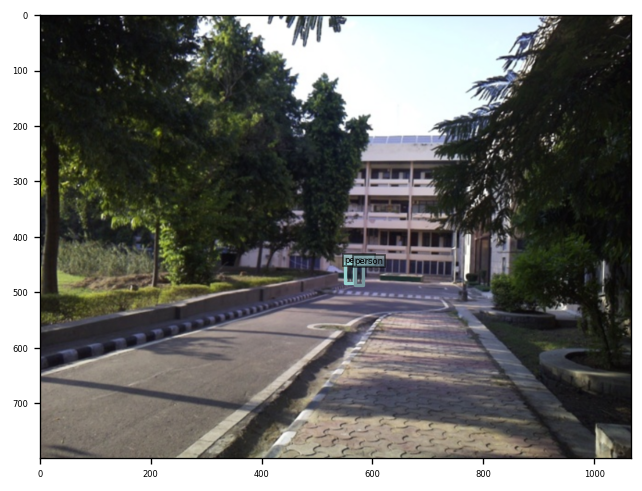

savename: /content/figs/original/orig_0010-41-2024-09-23-20:10:09.886743.png
41 not found


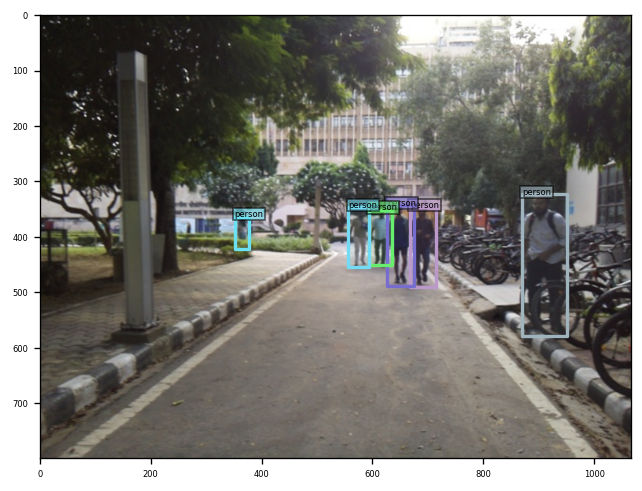

savename: /content/figs/original/orig_0011-51-2024-09-23-20:10:10.655162.png
51 not found


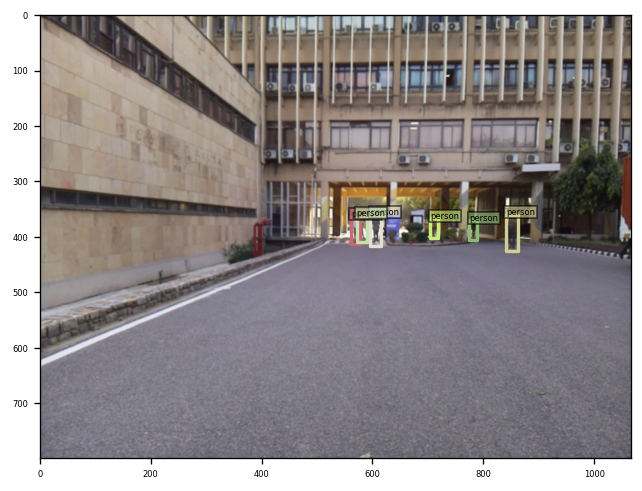

savename: /content/figs/original/orig_0012-56-2024-09-23-20:10:11.351614.png
56 not found


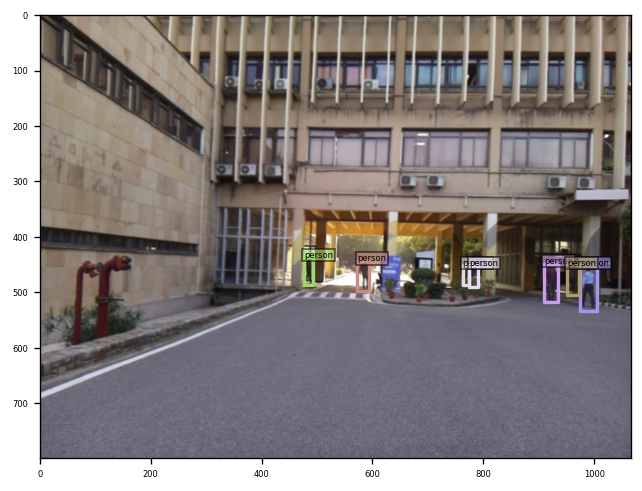

savename: /content/figs/original/orig_0013-57-2024-09-23-20:10:12.408791.png
57 not found


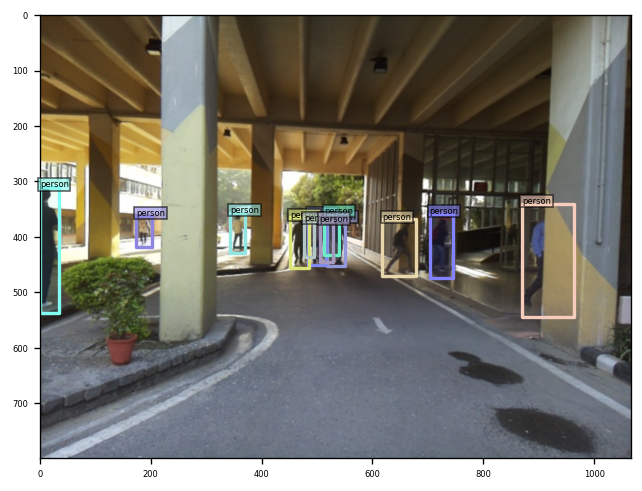

savename: /content/figs/original/orig_0014-58-2024-09-23-20:10:13.137351.png
58 not found


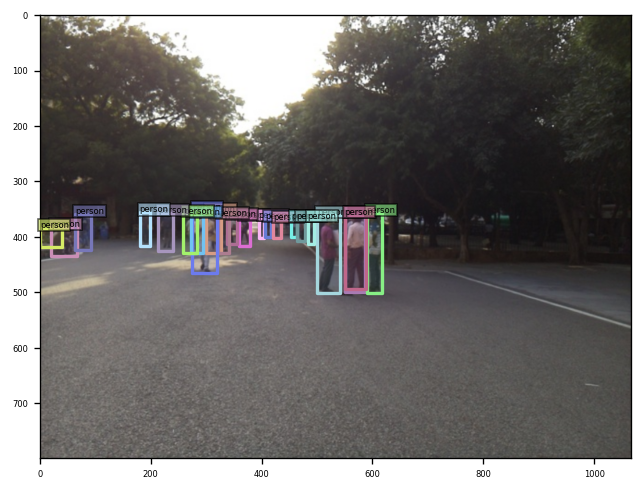

savename: /content/figs/original/orig_0015-60-2024-09-23-20:10:13.748437.png
60 not found


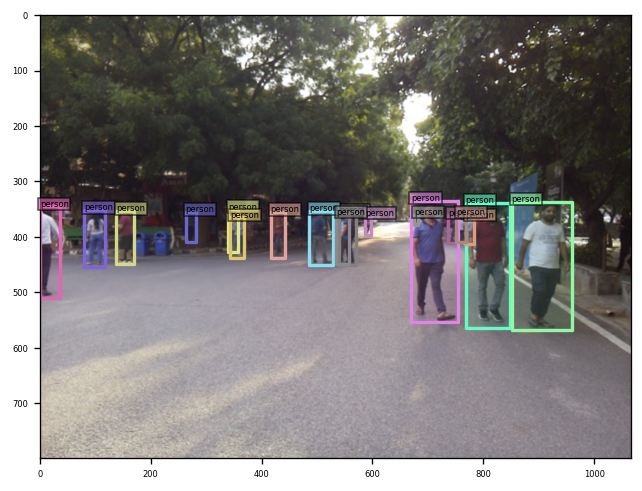

savename: /content/figs/original/orig_0016-63-2024-09-23-20:10:14.367371.png
63 not found


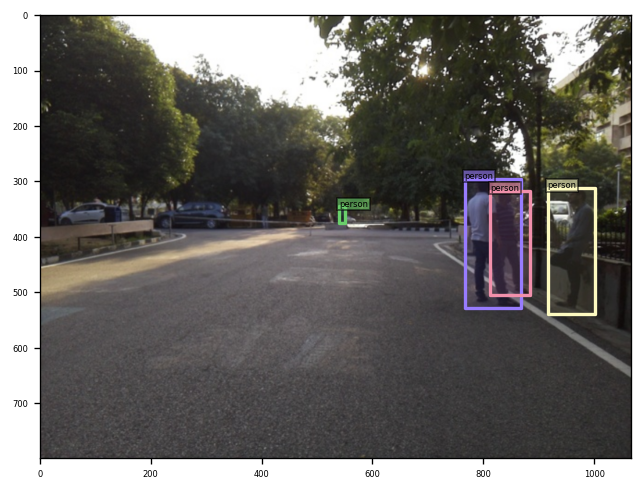

savename: /content/figs/original/orig_0017-71-2024-09-23-20:10:14.950523.png
71 not found


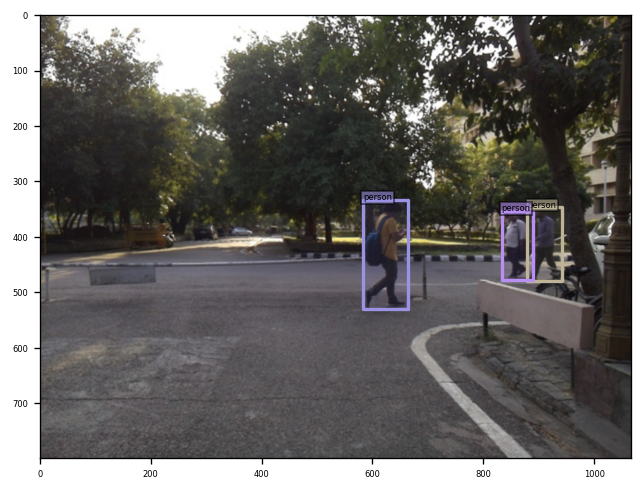

savename: /content/figs/original/orig_0018-72-2024-09-23-20:10:15.545634.png
72 not found


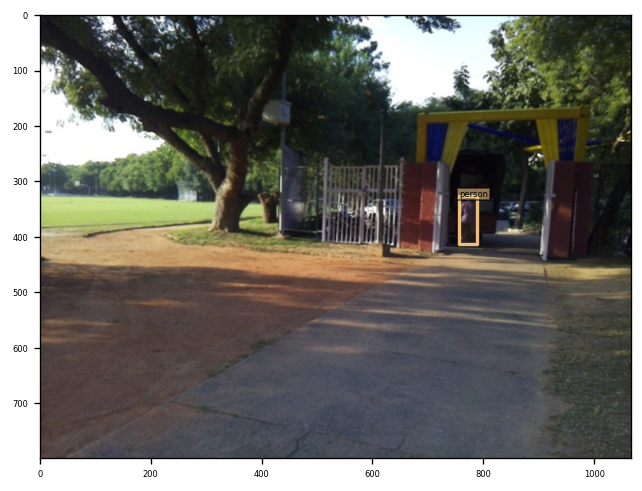

savename: /content/figs/original/orig_0019-88-2024-09-23-20:10:16.149345.png
88 not found


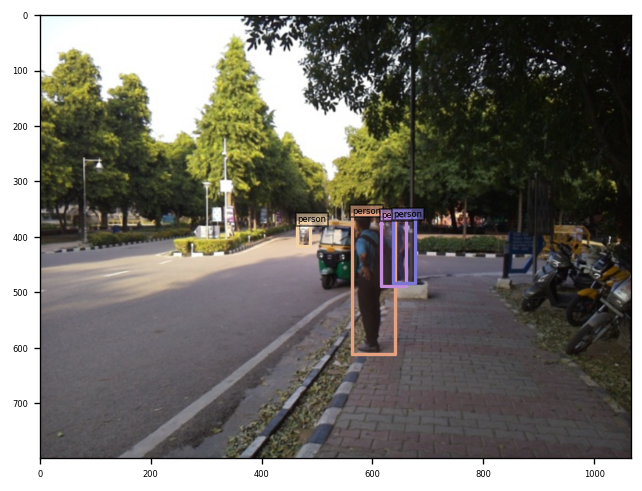

savename: /content/figs/original/orig_0020-108-2024-09-23-20:10:16.752075.png
108 not found


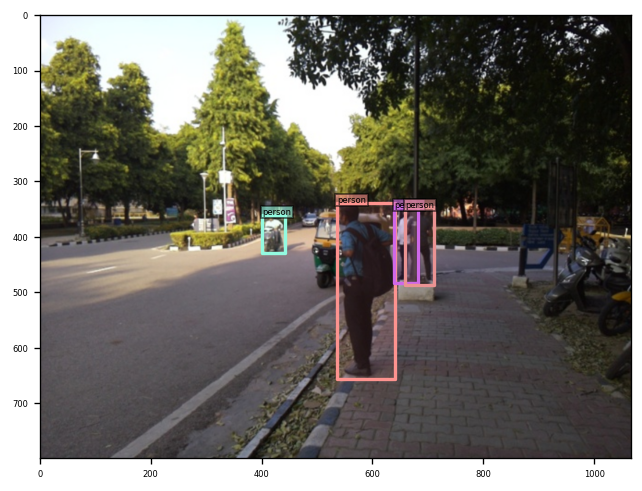

savename: /content/figs/original/orig_0021-109-2024-09-23-20:10:17.403631.png
109 not found


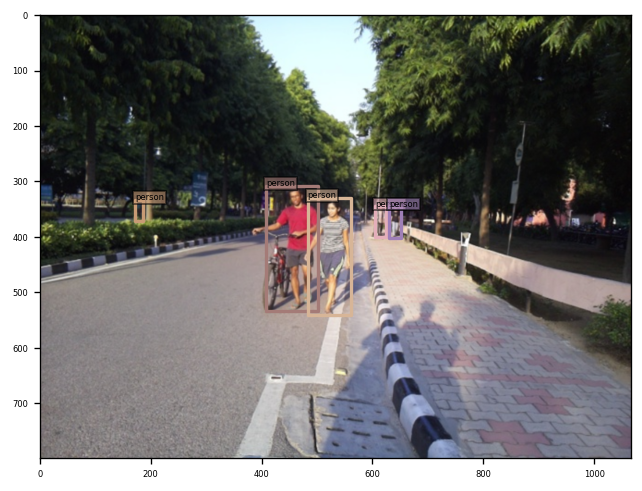

savename: /content/figs/original/orig_0022-115-2024-09-23-20:10:18.070244.png
115 not found


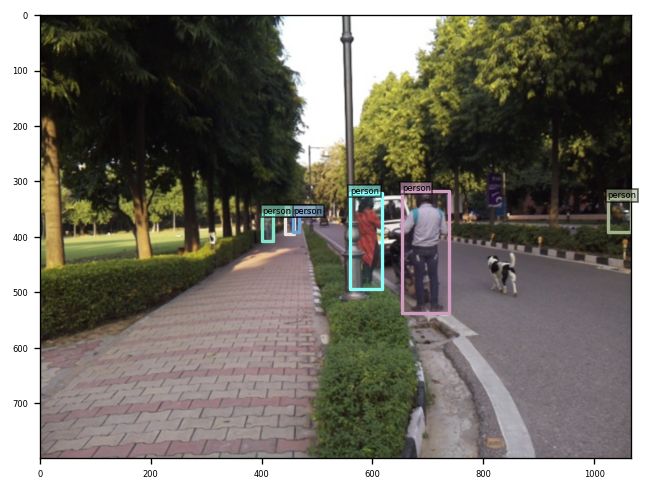

savename: /content/figs/original/orig_0023-130-2024-09-23-20:10:18.743005.png
130 not found


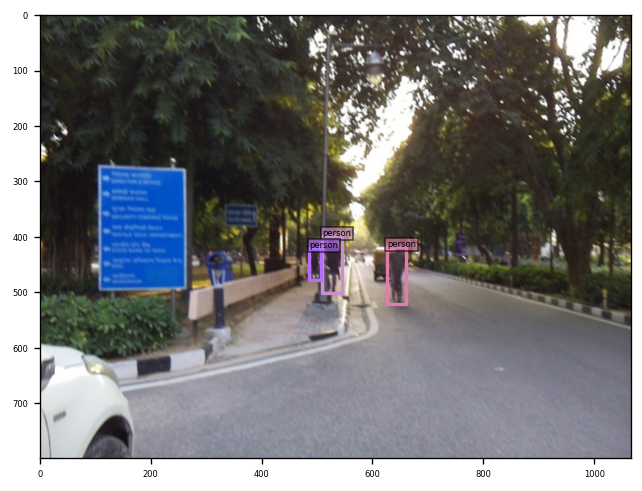

savename: /content/figs/original/orig_0024-140-2024-09-23-20:10:19.404333.png
140 not found


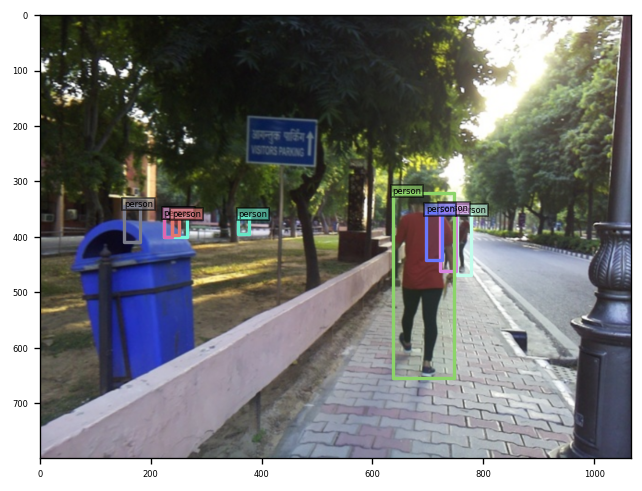

savename: /content/figs/original/orig_0025-144-2024-09-23-20:10:20.076236.png
144 not found


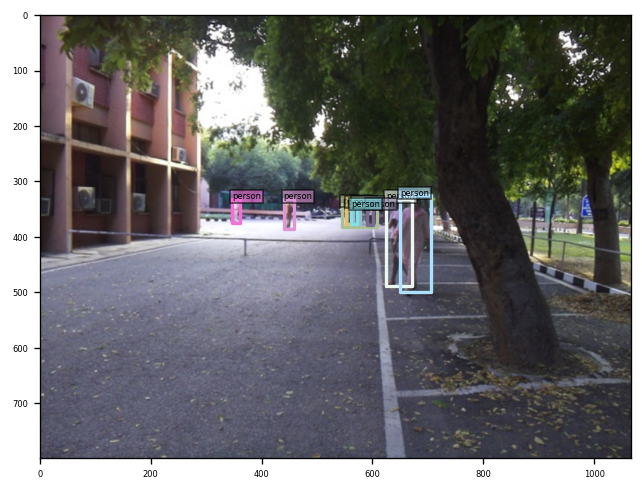

savename: /content/figs/original/orig_0026-151-2024-09-23-20:10:20.734977.png
151 not found


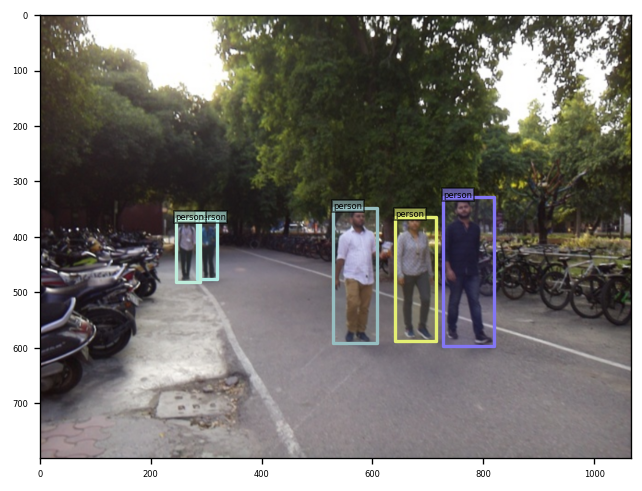

savename: /content/figs/original/orig_0027-152-2024-09-23-20:10:21.382500.png
152 not found


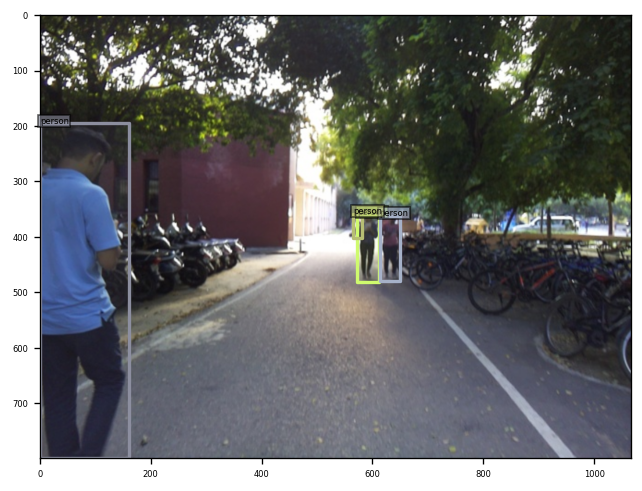

savename: /content/figs/original/orig_0028-155-2024-09-23-20:10:22.060501.png
155 not found


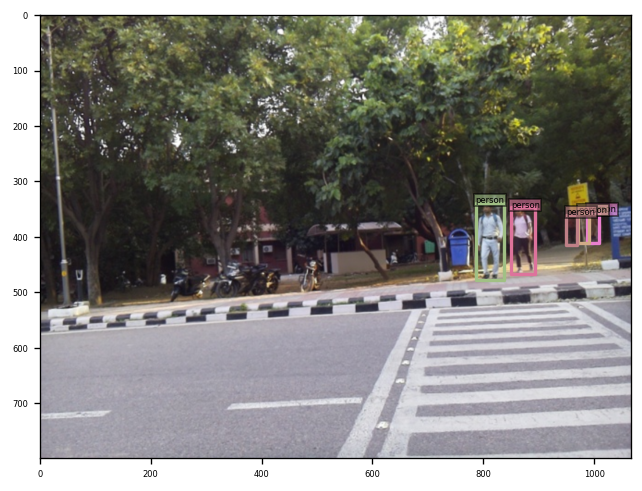

savename: /content/figs/original/orig_0029-164-2024-09-23-20:10:22.721408.png
164 not found


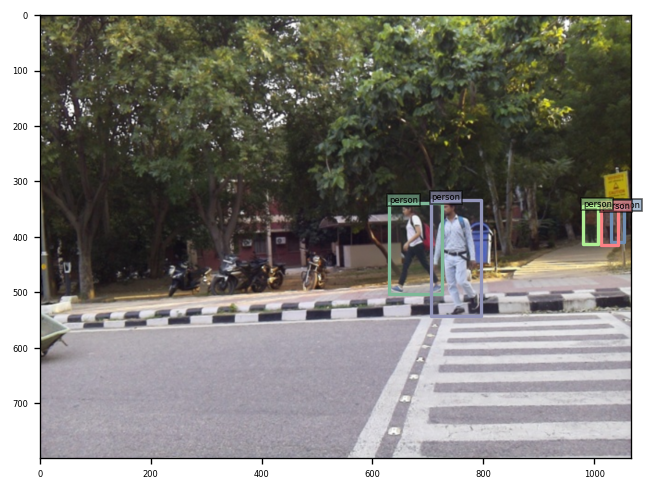

savename: /content/figs/original/orig_0030-167-2024-09-23-20:10:23.518745.png
167 not found


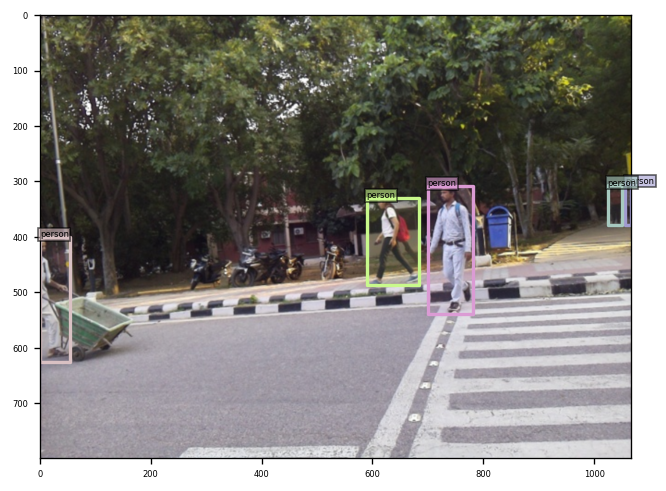

savename: /content/figs/original/orig_0031-168-2024-09-23-20:10:24.268978.png
168 not found


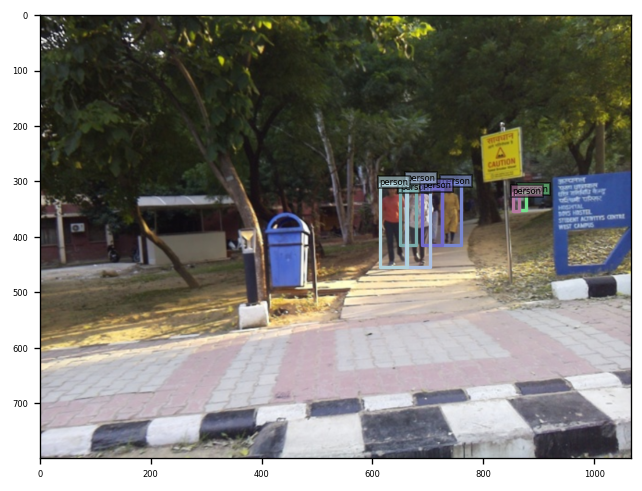

savename: /content/figs/original/orig_0032-174-2024-09-23-20:10:25.123786.png
174 not found


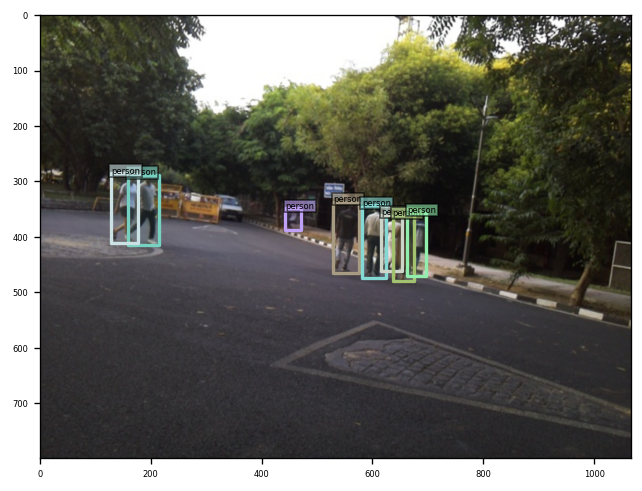

savename: /content/figs/original/orig_0033-181-2024-09-23-20:10:25.934032.png
181 not found


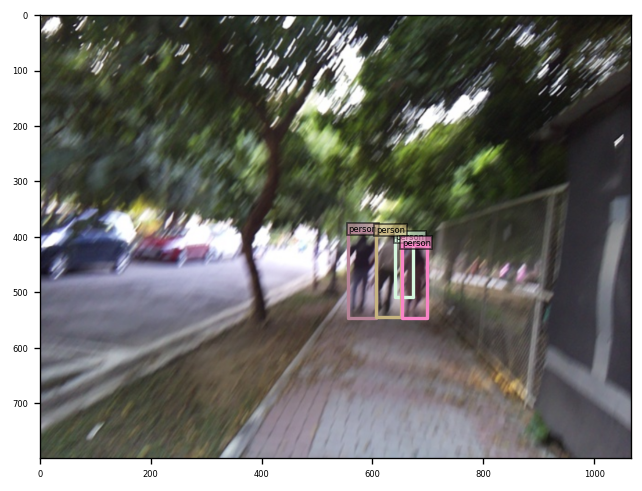

savename: /content/figs/original/orig_0034-185-2024-09-23-20:10:26.728425.png
185 not found


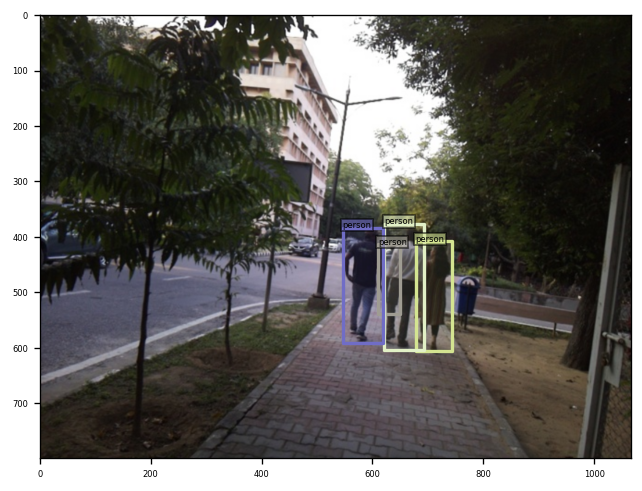

savename: /content/figs/original/orig_0035-188-2024-09-23-20:10:27.513246.png
188 not found


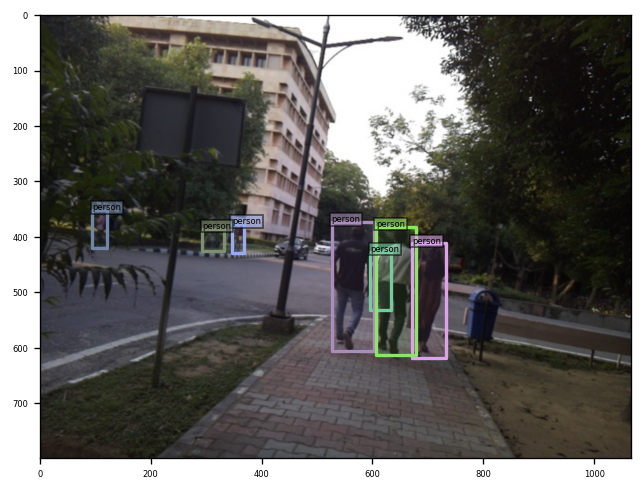

savename: /content/figs/original/orig_0036-189-2024-09-23-20:10:28.381231.png
189 not found


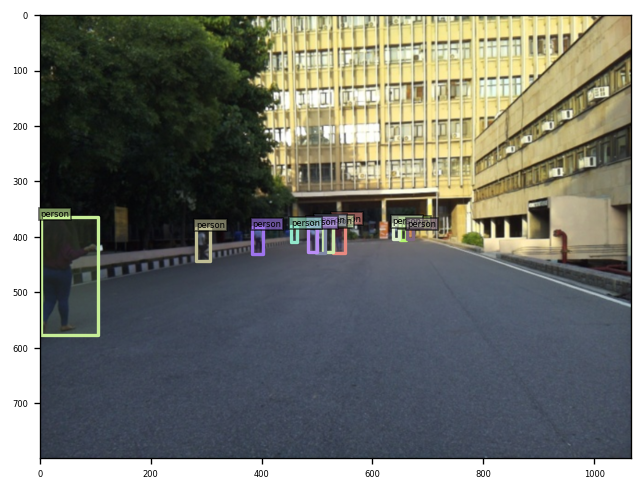

savename: /content/figs/original/orig_0037-190-2024-09-23-20:10:29.253129.png
190 not found


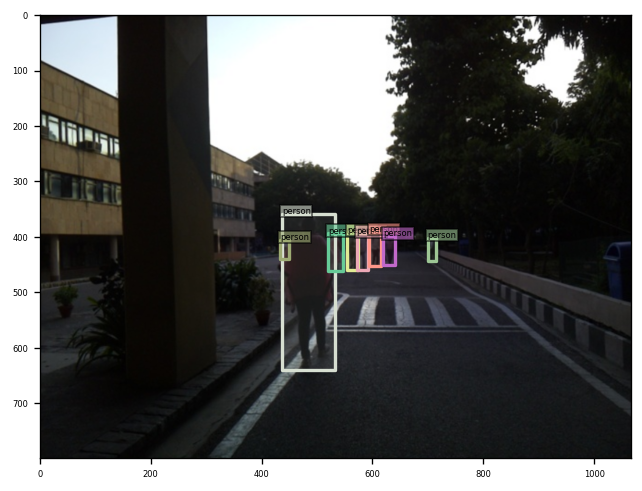

savename: /content/figs/original/orig_0038-197-2024-09-23-20:10:30.022659.png
197 not found
Error idx: 39


In [ ]:
model_config_path = "config/DINO/DINO_4scale.py"
args = SLConfig.fromfile(model_config_path)

args.device = 'cuda'
args.dataset_file = 'coco'
args.coco_path = "/content/coco_dataset" # the path of coco
args.fix_size = False

dataset_val = build_dataset(image_set='val', args=args)
vslzr = COCOVisualizer()
vslzr_2 = COCOVisualizer()

for i, batch in enumerate(dataset_val):
  img, targets = batch
  # print(i, img.shape, batch)
  box_label = ['person' for item in targets['labels']]
  gt_dict = {
    'boxes': targets['boxes'],
    'image_id': targets['image_id'],
    'size': targets['size'],
    'box_label': box_label,
  }
  # print(gt_dict)
  vslzr.visualize(img, gt_dict, caption=f"orig_{str(i).zfill(4)}", savedir="/content/figs/original")

  img_id = int(targets['image_id'].detach().cpu().numpy())
  if img_id in t5:
    box_label_pred = ['person' for ite in t5[img_id]['pred_boxes']]
    H, W = [480,600] # norm with original image size
    pred_dict = {
        'boxes': t5[img_id]['pred_boxes'].cpu() / torch.Tensor([W, H, W, H]),
        'image_id': targets['image_id'].cpu(),
        'size': t5[img_id]['size'].cpu(),
        'box_label': box_label_pred,
    }
    vslzr_2.visualize(img, pred_dict, caption=f"pred_{str(i).zfill(4)}", savedir="/content/figs/fine_tune_preds")
  else :
    print(f"{img_id} not found")

---     

---    

In [ ]:
!zip -r /content/selected_files.zip /content/* -x "/content/drive/*" "/content/coco_dataset/*" "/content/coco_custom/*"


In [ ]:
!zip -r /content/logs.zip /content/logs


  adding: content/logs/ (stored 0%)
  adding: content/logs/DINO/ (stored 0%)
  adding: content/logs/DINO/fine_tune_R50-MS4/ (stored 0%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0001.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint_best_regular.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/log.txt (deflated 79%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0005.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0002.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/config_args_all.json (deflated 64%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0000.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0003.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/checkpoint0004.pth (deflated 8%)
  adding: content/logs/DINO/fine_tune_R50-MS4/eval/ (stored 0%)
  adding: content/logs/DINO/fine_tune_R50-MS4/eval/latest.pth (deflated 91%)
  adding: 

In [ ]:
!cp /content/logs.zip /content/drive/MyDrive/DINO